# Assignment 771763
## Name: IFEANYI ANTHONY OKPALA
## Student Number: 202203449

### Understanding Artificial Intelligence 
### Project: Fuel Consumption Rating and Emergency Vehicle Identification (Component 2)

### Project Task

The task is to predict the CO2 emission of the vehicles and to classify the vehicles based on the 
categorical variables.
You should answer the following questions:
1. Describe the steps required to train a model.
2. Attempt to use all the numerical continuous variables in the dataset provided to
build a model to predict the CO2 emission. Perform exploratory data analysis to 
select a subset of the variables and repeat the procedure. Compare your models 
and report if there are any differences in the models’ performances? Explain your 
findings. 
3. Determine whether there were any noticeable improvements in the CO2 emission 
from year 2010 to year 2014? Explain your findings.
4. Using each categorical variable as the target variable at each instance, determine 
which of the variables performed best in classifying the dataset. Explain your 
findings.
5. How did you check whether your models did not overfit?
6. State the performance measure(s) you were most interested in and the reason(s).
7. Can your models be deployed based on their performances? Explain.
8. Use only the non-categorical variables to form groups. Using internal and external 
evaluation metrics, determine which categorical variable best describes the groups 
formed.

In this project, We will need to install some packages as shown below:

`pip install sklearn`, `pip install seaborn` and `pip install imblearn`

In [1]:
!pip install imblearn

Defaulting to user installation because normal site-packages is not writeable


### Task 1
Describe the steps required to train a model.

There are various steps required for us to start training testing and validating models.


* Data cleaning and preparation: This is the process of fixing or removing incorrect data within a dataset.
* Data visualisation : Exploratory Data Analysis is used to detect variable variable performance. 
* Feature selection : This is the process of selecting a subset of relevant features for use in model construction.
* Model selection : Building the machine learning model


### Data cleaning and preparation
We can start by importing relevant libaries before proceeding with data cleaning.

In [2]:
# Importing relevant libraries. 

# General libraries.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns
#import itertools
# Models libraries.
from sklearn.linear_model import LinearRegression  
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.svm import SVR
from sklearn.svm import SVC 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import cross_validate, KFold, cross_val_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import OneHotEncoder, LabelEncoder,MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.metrics import classification_report, confusion_matrix,ConfusionMatrixDisplay
from sklearn.compose import make_column_selector as selector
from sklearn.pipeline import make_pipeline, Pipeline
from imblearn.pipeline import Pipeline as impipeline
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import silhouette_score, davies_bouldin_score, v_measure_score,rand_score


from imblearn.over_sampling import SMOTE



In [3]:
# Let's read the csv file.

fuel_data = pd.read_csv("./fuel_consumption_data.csv")

# Let's create a copy of the dataframe 'census_c_df' so we can still have the original named 'census_df' while we clean.
fuel_data_df = fuel_data
fuel_data_df.head(3)   # Let's see the first three(3) rows.

C:\Program Files\ArcGIS\Pro\bin\Python\envs\arcgispro-py3\lib\site-packages\IPython\core\interactiveshell.py:3437: DtypeWarning: Columns (0,4,8,9,10,11,12) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,MODEL,MAKE,MODEL.1,VEHICLE CLASS,ENGINE SIZE,CYLINDERS,TRANSMISSION,FUEL,FUEL CONSUMPTION*,Unnamed: 9,...,Unnamed: 211,Unnamed: 212,Unnamed: 213,Unnamed: 214,Unnamed: 215,Unnamed: 216,Unnamed: 217,Unnamed: 218,Unnamed: 219,Unnamed: 220
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2010,ACURA,CSX,COMPACT,2.0,4.0,AS5,X,10.9,7.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2010,ACURA,CSX,COMPACT,2.0,4.0,M5,X,10.0,7.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
# We might need to investigate the columns of our data set.

fuel_data_df.columns

Index(['MODEL', 'MAKE', 'MODEL.1', 'VEHICLE CLASS', 'ENGINE SIZE', 'CYLINDERS',
       'TRANSMISSION', 'FUEL', 'FUEL CONSUMPTION*', 'Unnamed: 9',
       ...
       'Unnamed: 211', 'Unnamed: 212', 'Unnamed: 213', 'Unnamed: 214',
       'Unnamed: 215', 'Unnamed: 216', 'Unnamed: 217', 'Unnamed: 218',
       'Unnamed: 219', 'Unnamed: 220'],
      dtype='object', length=221)

In [5]:
# Let's rename the columns.

fuel_data_df.rename(columns = {
    'MODEL': 'Model_Year', 
    'MAKE': 'Make', 
    'MODEL.1': 'Model',
    'VEHICLE CLASS': 'Vehicle_Class',
    'ENGINE SIZE': 'Engine_Size',
    'CYLINDERS': 'Cylinders',
    'TRANSMISSION': 'Transmission',
    'FUEL': 'Fuel',
    'FUEL CONSUMPTION*': 'Fuel_Consumption_City(L/100 km)',
    'Unnamed: 9': 'Fuel_Consumption_HWY(L/100 km)',
    'Unnamed: 10': 'Fuel_Consumption_COMB(L/100 km)',
    'Unnamed: 11': 'Fuel_Consumption_COMB(mpg)',
    'CO2 EMISSIONS ': 'CO2_Emissions'    
}, inplace=True)

In [6]:
# Let's clear all excess columns NAN columns in our data set.

try:
    
    fuel_data_df.drop( [fuel_data_df.columns[i] for i in range(13,221)], axis = 1, inplace=True)
    
except Exception as err:
    
    print("Selected column(s) already cleared!\n")
    
try:
    
    fuel_data_df.drop(index=0, inplace=True) 
    
except Exception as err:
    
    print("Selected row(s) already cleared!\n")  
finally:
    print("Done.")
    

Done.


In [7]:
# Let's reconfirm our cleaning so far by checking the first five rows of our data set.

fuel_data_df.head()

,Model_Year,Make,Model,Vehicle_Class,Engine_Size,Cylinders,Transmission,Fuel,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
1,2010,ACURA,CSX,COMPACT,2.0,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2.0,4.0,M5,X,10.0,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2.0,4.0,M6,Z,11.6,8.1,10.0,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
5,2010,ACURA,RDX AWD TURBO,SUV,2.3,4.0,AS5,Z,13.2,10.3,11.9,24,274


In [8]:
# Data type conversion for certain variables. 

fuel_data_df[['Engine_Size', 
         'Fuel_Consumption_City(L/100 km)', 
         'Fuel_Consumption_HWY(L/100 km)', 
         'Fuel_Consumption_COMB(L/100 km)', 
         'Fuel_Consumption_COMB(mpg)', 
         'CO2_Emissions']] = fuel_data_df[['Engine_Size', 
         'Fuel_Consumption_City(L/100 km)', 
         'Fuel_Consumption_HWY(L/100 km)', 
         'Fuel_Consumption_COMB(L/100 km)', 
         'Fuel_Consumption_COMB(mpg)', 
         'CO2_Emissions']].astype(float)

fuel_data_df['Model_Year'] = fuel_data_df['Model_Year'].astype(int)

# EDA data confirmation

fuel_data_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Model_Year                       5359 non-null   int32  
 1   Make                             5359 non-null   object 
 2   Model                            5359 non-null   object 
 3   Vehicle_Class                    5359 non-null   object 
 4   Engine_Size                      5359 non-null   float64
 5   Cylinders                        5359 non-null   float64
 6   Transmission                     5359 non-null   object 
 7   Fuel                             5359 non-null   object 
 8   Fuel_Consumption_City(L/100 km)  5359 non-null   float64
 9   Fuel_Consumption_HWY(L/100 km)   5359 non-null   float64
 10  Fuel_Consumption_COMB(L/100 km)  5359 non-null   float64
 11  Fuel_Consumption_COMB(mpg)       5359 non-null   float64
 12  CO2_Emissions       

In [9]:
# Let's reconfirm our cleaning so far by checking the first five rows of our data set.

fuel_data_df.head()

,Model_Year,Make,Model,Vehicle_Class,Engine_Size,Cylinders,Transmission,Fuel,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
1,2010,ACURA,CSX,COMPACT,2.0,4.0,AS5,X,10.9,7.8,9.5,30.0,219.0
2,2010,ACURA,CSX,COMPACT,2.0,4.0,M5,X,10.0,7.6,8.9,32.0,205.0
3,2010,ACURA,CSX,COMPACT,2.0,4.0,M6,Z,11.6,8.1,10.0,28.0,230.0
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21.0,304.0
5,2010,ACURA,RDX AWD TURBO,SUV,2.3,4.0,AS5,Z,13.2,10.3,11.9,24.0,274.0


In [10]:
# Let's observe key statistics in our data.

fuel_data_df.describe().T  # T for Transpose 

,count,mean,std,min,25%,50%,75%,max
Model_Year,5359.0,2012.014742,1.404536,2010.0,2011.0,2012.0,2013.0,2014.0
Engine_Size,5359.0,3.491901,1.390957,1.0,2.4,3.5,4.6,8.4
Cylinders,5359.0,5.962120,1.872838,2.0,4.0,6.0,8.0,16.0
Fuel_Consumption_City(L/100 km),5359.0,13.902650,4.162894,4.5,11.0,13.2,16.0,30.4
Fuel_Consumption_HWY(L/100 km),5359.0,9.932208,2.807196,4.9,8.0,9.3,11.2,20.8
Fuel_Consumption_COMB(L/100 km),5359.0,12.116328,3.524127,4.7,9.7,11.4,13.9,26.0
Fuel_Consumption_COMB(mpg),5359.0,25.168875,6.956407,11.0,20.0,25.0,29.0,60.0
CO2_Emissions,5359.0,267.660198,64.317040,108.0,221.0,260.0,305.0,566.0


In [11]:
# let's confirm if the columns has nan values in them.

fuel_data_df.isna().sum()

Model_Year                         0
Make                               0
Model                              0
Vehicle_Class                      0
Engine_Size                        0
Cylinders                          0
Transmission                       0
Fuel                               0
Fuel_Consumption_City(L/100 km)    0
Fuel_Consumption_HWY(L/100 km)     0
Fuel_Consumption_COMB(L/100 km)    0
Fuel_Consumption_COMB(mpg)         0
CO2_Emissions                      0
dtype: int64

In [12]:
# Let's reconfirm for duplicates.

fuel_data_df.duplicated().sum()

0

In [13]:
# The dimension and size of our data.

fuel_data_df.shape

(5359, 13)

<Figure size 1200x800 with 0 Axes>

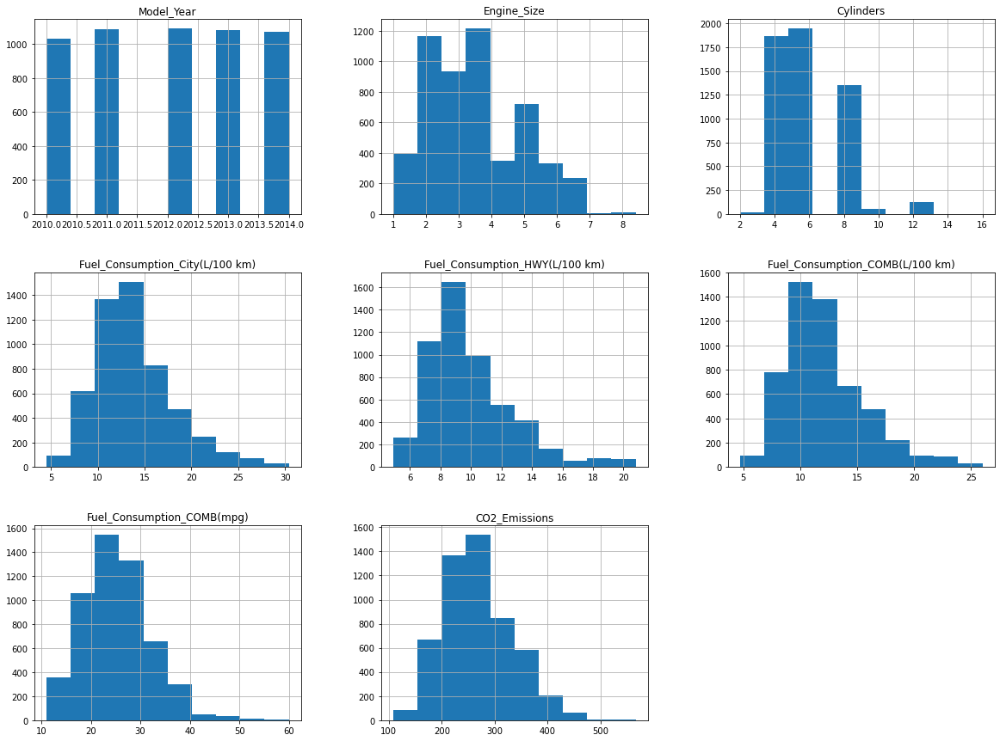

In [14]:
# visualizing our cleaned data set using histogram plot.

plt.figure(dpi=200)
fuel_data_df.hist(figsize=(20,15))
plt.show()

In [15]:
# From our statistics we can see that the count is complete for all numerical columns.

fuel_data_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Model_Year,5359.0,2012.014742,1.404536,2010.0,2011.0,2012.0,2013.0,2014.0
Engine_Size,5359.0,3.491901,1.390957,1.0,2.4,3.5,4.6,8.4
Cylinders,5359.0,5.962120,1.872838,2.0,4.0,6.0,8.0,16.0
Fuel_Consumption_City(L/100 km),5359.0,13.902650,4.162894,4.5,11.0,13.2,16.0,30.4
Fuel_Consumption_HWY(L/100 km),5359.0,9.932208,2.807196,4.9,8.0,9.3,11.2,20.8
Fuel_Consumption_COMB(L/100 km),5359.0,12.116328,3.524127,4.7,9.7,11.4,13.9,26.0
Fuel_Consumption_COMB(mpg),5359.0,25.168875,6.956407,11.0,20.0,25.0,29.0,60.0
CO2_Emissions,5359.0,267.660198,64.317040,108.0,221.0,260.0,305.0,566.0


In [16]:
# Calling the .info() EDA, we can see the types for each column

fuel_data_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Model_Year                       5359 non-null   int32  
 1   Make                             5359 non-null   object 
 2   Model                            5359 non-null   object 
 3   Vehicle_Class                    5359 non-null   object 
 4   Engine_Size                      5359 non-null   float64
 5   Cylinders                        5359 non-null   float64
 6   Transmission                     5359 non-null   object 
 7   Fuel                             5359 non-null   object 
 8   Fuel_Consumption_City(L/100 km)  5359 non-null   float64
 9   Fuel_Consumption_HWY(L/100 km)   5359 non-null   float64
 10  Fuel_Consumption_COMB(L/100 km)  5359 non-null   float64
 11  Fuel_Consumption_COMB(mpg)       5359 non-null   float64
 12  CO2_Emissions       

### Task 2
Attempt to use all the numerical continuous variables in the dataset provided to build a model to predict the CO2 emission. Perform exploratory data analysis to select a subset of the variables and repeat the procedure. Compare your models and report if there are any differences in the models’ performances? Explain your findings.

In [17]:
# First let's call our numerical continuous variables.

# In this data set, we have only 5 numerical continuous variables including CO2 Emissions.

# Fuel_Consumption_City(L/100 km), Fuel_Consumption_HWY(L/100 km), Fuel_Consumption_COMB(L/100 km), Fuel_Consumption_COMB(mpg), CO2_Emissions

numeric_df = fuel_data_df.select_dtypes(exclude ='object')

# Numerical continuous variables

numeric_cont_df = numeric_df.drop(['Model_Year', 'Cylinders'], axis = 1)

numeric_cont_df

,Engine_Size,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
1,2.0,10.9,7.8,9.5,30.0,219.0
2,2.0,10.0,7.6,8.9,32.0,205.0
3,2.0,11.6,8.1,10.0,28.0,230.0
4,3.7,14.8,11.3,13.2,21.0,304.0
5,2.3,13.2,10.3,11.9,24.0,274.0
...,...,...,...,...,...,...
5355,3.0,13.4,9.8,11.8,24.0,271.0
5356,3.2,13.2,9.5,11.5,25.0,264.0
5357,3.0,13.4,9.8,11.8,24.0,271.0
5358,3.2,12.9,9.3,11.3,25.0,260.0


In [18]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [19]:
# Creating the train, validation and test dataset, Let's split our dataset into train and test sets.
# 80% of the entire dataset will be used for training and 20% for testing.

X = numeric_cont_df.drop('CO2_Emissions', axis = 1)
y = numeric_cont_df['CO2_Emissions']

# With random_state=42, we get the same train and test sets across different executions, but in this time, 
# the train and test sets are different from the previous case with random_state=0

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) 

X,y=X_train,y_train

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

In [20]:
# Let's confrim data sharp
print(f"The shape of X training data is: {X_train.shape}")
print(f"The shape of X testing data is:{X_test.shape}")
print(f"The shape of X validation data is:{X_val.shape}")

The shape of X training data is: (3429, 5)
The shape of X testing data is:(1072, 5)
The shape of X validation data is:(858, 5)


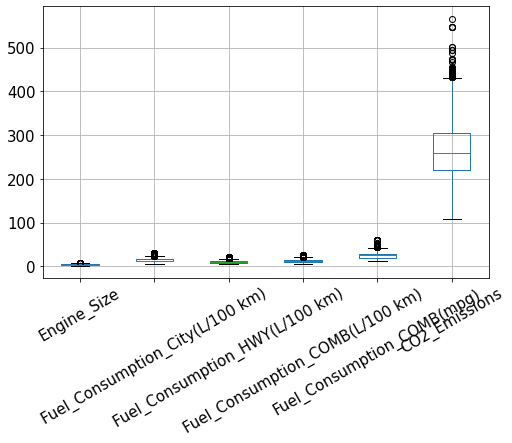

In [21]:
# The boxplot shows that some of the variables exert dominance over the others hence the need for scaling.

numeric_cont_df.boxplot(figsize = (8,5), fontsize = 15, rot = 30)
plt.show()

In [22]:
# Scaling the dataset
"""
So if the data in any conditions has data points far from each other, 
scaling is a technique to make them closer to each other or in simpler words, 
we can say that the scaling is used for making data points generalized 
so that the distance between them will be lower.

"""

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_val_scaled = scaler.transform(X_val)

In [23]:
#converting to pandas dataframe

X_train_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns)
X_val_scaled = pd.DataFrame(X_val_scaled, columns = X_val.columns)

In [24]:
X_train_scaled

,Engine_Size,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg)
0,0.364865,0.401544,0.383648,0.394366,0.224490
1,0.189189,0.289575,0.226415,0.267606,0.326531
2,0.351351,0.397683,0.314465,0.370892,0.224490
3,0.351351,0.397683,0.433962,0.408451,0.204082
4,0.729730,0.474903,0.345912,0.431925,0.183673
...,...,...,...,...,...
3424,0.445946,0.471042,0.534591,0.492958,0.163265
3425,0.351351,0.474903,0.339623,0.431925,0.183673
3426,0.608108,0.413127,0.345912,0.389671,0.224490
3427,0.675676,0.702703,0.635220,0.680751,0.081633


In [25]:
from sklearn.linear_model import LinearRegression # importing the model for LR 
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score


In [26]:
# Multiple linear regression test report

def report_model_test(model):
    
    
    model.fit(X_train_scaled[X.columns],y_train)
    basem_preds = model.predict(X_test_scaled[X.columns]) 
    mean_abs = mean_absolute_error(y_test,basem_preds)
    mean_squared = mean_squared_error(y_test,basem_preds)
    print(f"The result of the mean_absolute_error is: {mean_abs:.2f}")
    print(f"The result of the root mean squared error is : {np.sqrt(mean_squared):.2f}")
    print(f"The result of the coefficient of determination is: {r2_score(y_test,basem_preds):.2f}")
        
report_model_test(LinearRegression()) # even if i don't put the argument for, it would still work cause of the previous cell.

The result of the mean_absolute_error is: 15.29
The result of the root mean squared error is : 23.50
The result of the coefficient of determination is: 0.87


In [27]:
# Appending several models for cross validation
models = []
models.append(("Linear_R", LinearRegression()))
models.append(("Dtree", DecisionTreeRegressor()))
models.append(("SVR", SVR()))
models

[('Linear_R', LinearRegression()),
 ('Dtree', DecisionTreeRegressor()),
 ('SVR', SVR())]

In [28]:
def report_cross_val_score(models):
    scores = []
    for name,model in models:
        kfold = KFold(n_splits=5)
        cv_result = np.sqrt(cross_val_score(model,X_train,y_train, cv = kfold, scoring = "neg_root_mean_squared_error")**2)
        cv1, cv2, cv3, cv4, cv5 = cv_result
        print(f"{name} root mean squared error is: {cv_result.mean():.2f}")
        scores.append((name,cv1, cv2, cv3, cv4, cv5,cv_result.mean()))
    return scores

report = report_cross_val_score(models)
report

Linear_R root mean squared error is: 23.88
Dtree root mean squared error is: 10.13
SVR root mean squared error is: 26.68


[('Linear_R',
  23.18460653495466,
  24.847967640915474,
  24.909708287204168,
  23.02166670854517,
  23.427049153529993,
  23.878199665029893),
 ('Dtree',
  12.938407156122786,
  11.865797140409313,
  8.07141213897649,
  8.995385136707242,
  8.803058341959252,
  10.134811982835016),
 ('SVR',
  26.25844897023122,
  27.39119347895774,
  28.66584428876454,
  25.727745122038304,
  25.377218550681487,
  26.684090082134656)]

In [29]:
col = [f"cv_score {i}" if i!=0 else "Model" for i in range(len(report[0])-1)]
report_df = pd.DataFrame(report, columns = col+["avg_score"])
report_df

,Model,cv_score 1,cv_score 2,cv_score 3,cv_score 4,cv_score 5,avg_score
0,Linear_R,23.184607,24.847968,24.909708,23.021667,23.427049,23.878200
1,Dtree,12.938407,11.865797,8.071412,8.995385,8.803058,10.134812
2,SVR,26.258449,27.391193,28.665844,25.727745,25.377219,26.684090


<AxesSubplot:xlabel='Model', ylabel='avg_score'>

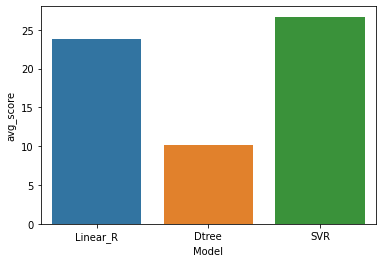

In [30]:
sns.barplot(data=report_df, x='Model',y='avg_score')

### Hyperparameter 1

In [31]:
from sklearn.model_selection import GridSearchCV

DecisionTreeRegressor().get_params()

{'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': None,
 'splitter': 'best'}

In [32]:
param = {'max_depth': range(1,20), 'min_samples_leaf': [1,2,3,4,5],'min_samples_split': [2,3,4,5],'splitter': ['best','random']}

In [33]:
search = GridSearchCV(estimator=DecisionTreeRegressor(), param_grid= param )

In [34]:
search.fit(X_train,y_train)

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': range(1, 20),
                         'min_samples_leaf': [1, 2, 3, 4, 5],
                         'min_samples_split': [2, 3, 4, 5],
                         'splitter': ['best', 'random']})

In [35]:
search.best_estimator_

DecisionTreeRegressor(max_depth=17, min_samples_split=3, splitter='random')

In [36]:
d_tree= DecisionTreeRegressor().fit(X_train, y_train)
predict = d_tree.predict(X_test)
msr_score = mean_squared_error(y_test, predict)
mae_score = mean_absolute_error(y_test, predict)
print(f"Mean Square Error is: {np.sqrt(msr_score)}")

Mean Square Error is: 7.246244237917706


### Performing exploratory data analysis(EDA) using heatmap 

<AxesSubplot:>

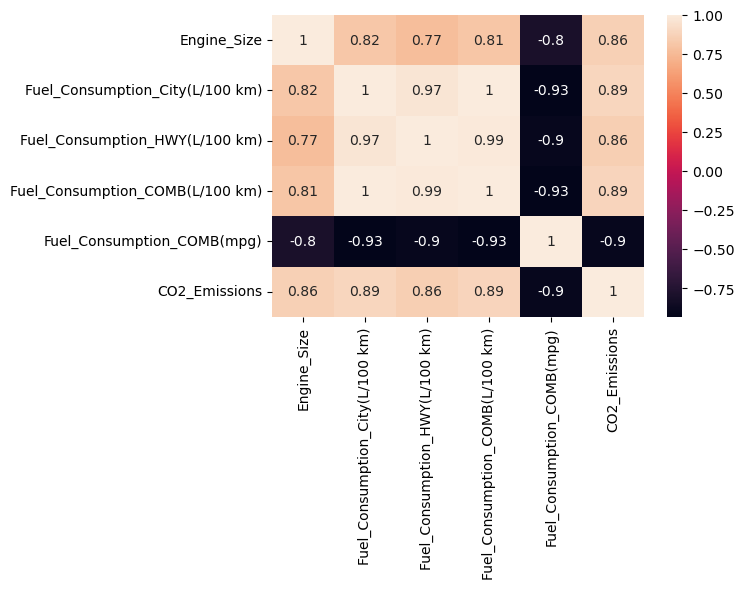

In [37]:
plt.figure(dpi=100)
sns.heatmap(numeric_cont_df.corr(), annot = True)

Since There is a 100% corrolation between Fuel_Consumption_COMB(L/100 km) and Fuel_Consumption_City(L/100 km), Let's drop one of these variables and create a new subset to repeat the process.

In [38]:
# Let's drop the variable 'Fuel_Consumption_City(L/100 km)'and create a new subset to repeat the process.

numeric_cont_df_2 = numeric_cont_df.drop(['Fuel_Consumption_City(L/100 km)'], axis = 1)
numeric_cont_df_2

,Engine_Size,Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
1,2.0,7.8,9.5,30.0,219.0
2,2.0,7.6,8.9,32.0,205.0
3,2.0,8.1,10.0,28.0,230.0
4,3.7,11.3,13.2,21.0,304.0
5,2.3,10.3,11.9,24.0,274.0
...,...,...,...,...,...
5355,3.0,9.8,11.8,24.0,271.0
5356,3.2,9.5,11.5,25.0,264.0
5357,3.0,9.8,11.8,24.0,271.0
5358,3.2,9.3,11.3,25.0,260.0


In [39]:
# Creating the train, validation and test dataset, Let's split our dataset into train and test sets.
# 80% of the entire dataset will be used for training and 20% for testing.

X2 = numeric_cont_df_2.drop('CO2_Emissions', axis = 1)
y2 = numeric_cont_df_2['CO2_Emissions']

# With random_state=42, we get the same train and test sets across different executions, but in this time, 
# the train and test sets are different from the previous case with random_state=0

X_train, X_test, y_train, y_test = train_test_split(X2, y2, test_size=0.2, random_state=42) 

X2, y2= X_train, y_train

X_train, X_val, y_train, y_val = train_test_split(X2, y2, test_size=0.2, random_state=42)

In [40]:
# Let's confrim data sharp
print(f"The shape of X training data is: {X_train.shape}")
print(f"The shape of X testing data is:{X_test.shape}")
print(f"The shape of X validation data is:{X_val.shape}")

The shape of X training data is: (3429, 4)
The shape of X testing data is:(1072, 4)
The shape of X validation data is:(858, 4)


In [41]:
# Scaling the dataset
"""
So if the data in any conditions has data points far from each other, 
scaling is a technique to make them closer to each other or in simpler words, 
we can say that the scaling is used for making data points generalized 
so that the distance between them will be lower.

"""

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_val_scaled = scaler.transform(X_val)

In [42]:
#converting to pandas dataframe

X_train_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns)
X_val_scaled = pd.DataFrame(X_val_scaled, columns = X_val.columns)

In [43]:
def report_model_test(model):
    
    
    model.fit(X_train_scaled[X2.columns],y_train)
    basem_preds = model.predict(X_test_scaled[X2.columns]) 
    mean_abs = mean_absolute_error(y_test,basem_preds)
    mean_squared = mean_squared_error(y_test,basem_preds)
    print(f"The result of the mean_absolute_error is: {mean_abs:.2f}")
    print(f"The result of the root mean squared error is : {np.sqrt(mean_squared):.2f}")
    print(f"The result of the coefficient of determination is: {r2_score(y_test,basem_preds):.2f}")
        
report_model_test(LinearRegression()) # even if i don't put the argument for, it would still work cause of the previous cell.

The result of the mean_absolute_error is: 15.22
The result of the root mean squared error is : 23.59
The result of the coefficient of determination is: 0.86


In [44]:
# Appending several models for cross validation
models = []
models.append(("Linear_R", LinearRegression()))
models.append(("Dtree", DecisionTreeRegressor()))
models.append(("SVR", SVR()))
models

[('Linear_R', LinearRegression()),
 ('Dtree', DecisionTreeRegressor()),
 ('SVR', SVR())]

In [45]:

def report_cross_val_score(models):
    scores = []
    for name,model in models:
        kfold = KFold(n_splits=5)
        cv_result = np.sqrt(cross_val_score(model,X_train,y_train, cv = kfold, scoring = "neg_root_mean_squared_error")**2)
        cv1, cv2, cv3, cv4, cv5 = cv_result
        print(f"{name} root mean squared error is: {cv_result.mean():.2f}")
        scores.append((name,cv1, cv2, cv3, cv4, cv5,cv_result.mean()))
    return scores

report = report_cross_val_score(models)
report

Linear_R root mean squared error is: 23.92
Dtree root mean squared error is: 8.84
SVR root mean squared error is: 26.20


[('Linear_R',
  23.181949228844406,
  24.84415525949949,
  25.004826677248243,
  23.058002350917473,
  23.524561370498102,
  23.922698977401545),
 ('Dtree',
  10.892717128574885,
  13.136364321808836,
  5.924104606360967,
  6.160041256082949,
  8.071584508640777,
  8.836962364293683),
 ('SVR',
  25.736333916098594,
  26.763897305823306,
  28.04062918794393,
  25.527637004040212,
  24.933863141379106,
  26.20047211105703)]

In [46]:
col = [f"cv_score {i}" if i!=0 else "Model" for i in range(len(report[0])-1)]
report_df = pd.DataFrame(report, columns = col+["avg_score"])
report_df

,Model,cv_score 1,cv_score 2,cv_score 3,cv_score 4,cv_score 5,avg_score
0,Linear_R,23.181949,24.844155,25.004827,23.058002,23.524561,23.922699
1,Dtree,10.892717,13.136364,5.924105,6.160041,8.071585,8.836962
2,SVR,25.736334,26.763897,28.040629,25.527637,24.933863,26.200472


<AxesSubplot:xlabel='Model', ylabel='avg_score'>

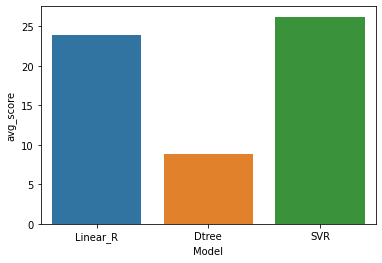

In [47]:
sns.barplot(data=report_df, x='Model',y='avg_score')

### Hyperparameter 2

In [48]:
from sklearn.model_selection import GridSearchCV

DecisionTreeRegressor().get_params()

{'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': None,
 'splitter': 'best'}

In [49]:
param = {'max_depth': range(1,20), 'min_samples_leaf': [1,2,3,4,5],'min_samples_split': [2,3,4,5],'splitter': ['best','random']}

In [50]:
search = GridSearchCV(estimator=DecisionTreeRegressor(), param_grid= param )

In [51]:
search.fit(X_train,y_train)

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': range(1, 20),
                         'min_samples_leaf': [1, 2, 3, 4, 5],
                         'min_samples_split': [2, 3, 4, 5],
                         'splitter': ['best', 'random']})

In [52]:
search.best_estimator_

DecisionTreeRegressor(max_depth=18, min_samples_split=3, splitter='random')

In [53]:
d_tree= DecisionTreeRegressor().fit(X_train, y_train)
predict = d_tree.predict(X_test)
msr_score = mean_squared_error(y_test, predict)
mae_score = mean_absolute_error(y_test, predict)
print(f"Mean Square Error is: {np.sqrt(msr_score)}")

Mean Square Error is: 8.179351417543938


From our findings we can see that there are no singnificant difference in the result, the coefficient of determination is the same. This result is expected being that all the numerical contineous variables in our data set already have a high corrolation with the independent variable f(x)

### Task 3
Determine whether there were any noticeable improvements in the CO2 emission from year 2010 to year 2014? Explain your findings.


In [54]:
# First we will need to convert our year column to a string type.

fuel_data_df['Model_Year'] = fuel_data_df['Model_Year'].apply(str)

<AxesSubplot:xlabel='Model_Year', ylabel='CO2_Emissions'>

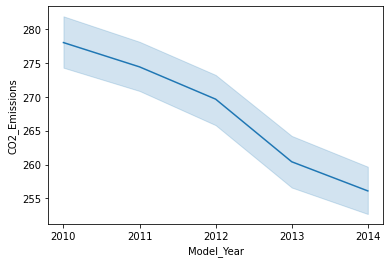

In [55]:
# Let's plot a line plot using seaborn.

sns.lineplot(data=fuel_data_df, x='Model_Year', y='CO2_Emissions')

From the year 2010 to 2014, there seem to be a decrease in CO2_Emissions by 279 to around 255 respectively for the average.

### Task 4
Using each categorical variable as the target variable at each instance, determine 
which of the variables performed best in classifying the dataset. Explain your 
findings.

### Classification

In [56]:
object_df = fuel_data_df.select_dtypes(include ='object')
object_df

,Model_Year,Make,Model,Vehicle_Class,Transmission,Fuel
1,2010,ACURA,CSX,COMPACT,AS5,X
2,2010,ACURA,CSX,COMPACT,M5,X
3,2010,ACURA,CSX,COMPACT,M6,Z
4,2010,ACURA,MDX AWD,SUV,AS6,Z
5,2010,ACURA,RDX AWD TURBO,SUV,AS5,Z
...,...,...,...,...,...,...
5355,2014,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5356,2014,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5357,2014,VOLVO,XC70 AWD,SUV - SMALL,AS6,X
5358,2014,VOLVO,XC70 AWD,SUV - SMALL,AS6,X


In [57]:
# Let's observe our object columns categories.

for i in object_df.columns:
        print(f"{i}: {len(object_df[i].unique())}")


Model_Year: 5
Make: 45
Model: 1210
Vehicle_Class: 17
Transmission: 22
Fuel: 4


In [58]:
X = numeric_df
y = object_df['Fuel']

In [59]:
# Appling SMOTE

sm = SMOTE(random_state=42, k_neighbors = 2) # The object is created 
X_res, y_res = sm.fit_resample(X, y) # The object is applied
X, y = X_res, y_res # reassigning the balanced dataset to X,y

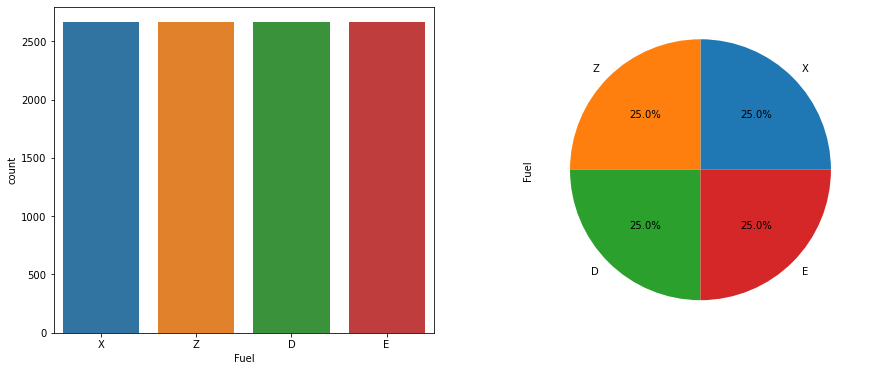

In [60]:
# Plot of the dataset 
df_bal = pd.concat([X_res,y_res], axis = 1) # creating a dataframe for the balanced data
fig, ax=plt.subplots(1,2,figsize=(15,6)) # creating the axis shell for subplot
a = sns.countplot(x='Fuel',data=df_bal, ax=ax[0]) # assigning each of the plot to the axis shell
a= df_bal['Fuel'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1]) # assigning each of the plot to the axis shell

In [61]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X,y=X_train,y_train
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

,Model_Year,Engine_Size,Cylinders,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
772,2010,1.800000,4.0,9.4,7.900000,8.7,32.0,200.0
10647,2010,4.191913,8.0,17.1,11.747978,14.7,19.0,338.0
4359,2014,4.000000,8.0,17.4,10.200000,14.2,20.0,332.0
4732,2014,5.300000,8.0,23.9,18.500000,21.5,13.0,344.0
9329,2012,6.200000,8.0,25.5,17.400000,21.9,13.0,350.0
...,...,...,...,...,...,...,...,...
2459,2012,5.400000,8.0,26.7,20.500000,23.9,12.0,382.0
3607,2013,5.000000,8.0,16.7,12.500000,14.8,19.0,340.0
6337,2012,3.000000,6.0,10.8,7.100000,9.1,31.0,246.0
3463,2013,6.000000,8.0,11.5,9.900000,10.8,26.0,248.0


Let's use cross validation to evaluate the performance of machine learning models.

In [62]:
from sklearn.model_selection import cross_validate, KFold, cross_val_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score

In [63]:
# Appending several models for cross validation
models = []
models.append(("LR",LogisticRegression()))
models.append(("KNN",KNeighborsClassifier()))
models.append(("Dtree",DecisionTreeClassifier()))
models.append(("SVC",SVC()))
models.append(("RF",RandomForestClassifier()))
models


[('LR', LogisticRegression()),
 ('KNN', KNeighborsClassifier()),
 ('Dtree', DecisionTreeClassifier()),
 ('SVC', SVC()),
 ('RF', RandomForestClassifier())]

In [64]:
def report_cross_val_score(models):
    for name,model in models:
        kfold = KFold(n_splits=5)
        cv_result = cross_val_score(model,X_train,y_train, cv = kfold,scoring = "accuracy")
        #print(name, cv_result.mean())
        print(name, cv_result)
 
 
report_cross_val_score(models)

C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_mo

LR [0.76099707 0.74981658 0.78503302 0.77622891 0.82758621]
KNN [0.87609971 0.85693324 0.86867205 0.87087307 0.86647102]
Dtree [0.93475073 0.94277329 0.95377843 0.93763756 0.94937638]
SVC [0.35997067 0.33675715 0.3382245  0.3624358  0.37637564]
RF [0.94281525 0.94644167 0.95451211 0.94937638 0.95524578]


In [65]:
X_train

,Model_Year,Engine_Size,Cylinders,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
772,2010,1.800000,4.0,9.4,7.900000,8.7,32.0,200.0
10647,2010,4.191913,8.0,17.1,11.747978,14.7,19.0,338.0
4359,2014,4.000000,8.0,17.4,10.200000,14.2,20.0,332.0
4732,2014,5.300000,8.0,23.9,18.500000,21.5,13.0,344.0
9329,2012,6.200000,8.0,25.5,17.400000,21.9,13.0,350.0
...,...,...,...,...,...,...,...,...
2459,2012,5.400000,8.0,26.7,20.500000,23.9,12.0,382.0
3607,2013,5.000000,8.0,16.7,12.500000,14.8,19.0,340.0
6337,2012,3.000000,6.0,10.8,7.100000,9.1,31.0,246.0
3463,2013,6.000000,8.0,11.5,9.900000,10.8,26.0,248.0


In [66]:
#function to run the entire process
def train_and_evaluate_ds(X, y):
    #separate columns by type
    numerical_columns_selector = selector(dtype_exclude=object)
    categorical_columns_selector = selector(dtype_include=object)
    
    numerical_data = numerical_columns_selector(X)
    categorical_data = categorical_columns_selector(X)
    
    #instantiate preprocessors for the columns
    categorical_preprocessor = OneHotEncoder()
    numerical_preprocessor = MinMaxScaler()



    preprocessor = ColumnTransformer([
        ('one_hot_encoder', categorical_preprocessor, categorical_data),
        ('minmax_scaler', numerical_preprocessor, numerical_data)])
    
    #create pipeline to run the steps
    #print('creating pipe to run steps')
    pipe = impipeline(steps=[('preprocessor',preprocessor),
                           ('smote', SMOTE(k_neighbors=1,random_state=42))])   
    
    #split data into training and testing dataset   
    X, y = pipe.fit_resample(X,y)
    
    train_data, test_data, train_target, test_target = train_test_split(X, y, random_state=42)
    
    #fit pipeline on training dataset
    model = RandomForestClassifier()
    model.fit(train_data, train_target)
    
    #get predictions for test datasets
    preds = model.predict(test_data)

    print(classification_report(test_target,preds))
    
    ConfusionMatrixDisplay.from_estimator(model,test_data,test_target )
    plt.show()
    plt.figure(figsize=(40,40))

In [67]:
X = fuel_data_df.drop(['Fuel','Make','Model'], axis =1) #This is no neighbor to work with so we drop MAKE AND MODEL
y = fuel_data_df['Fuel']

              precision    recall  f1-score   support

           D       1.00      1.00      1.00       667
           E       1.00      1.00      1.00       653
           X       0.94      0.97      0.96       642
           Z       0.98      0.95      0.96       701

    accuracy                           0.98      2663
   macro avg       0.98      0.98      0.98      2663
weighted avg       0.98      0.98      0.98      2663



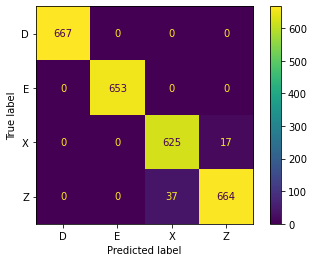

<Figure size 2880x2880 with 0 Axes>

In [68]:
from sklearn.ensemble import RandomForestClassifier

from imblearn.over_sampling import SMOTE

train_and_evaluate_ds(X, y)

              precision    recall  f1-score   support

          A4       0.94      0.92      0.93       250
          A5       0.92      0.94      0.93       276
          A6       0.84      0.79      0.81       254
          A7       0.91      0.98      0.94       258
          A8       0.94      0.95      0.94       304
          A9       0.99      1.00      0.99       247
         AM5       1.00      1.00      1.00       262
         AM6       0.96      1.00      0.98       267
         AM7       0.97      0.97      0.97       266
         AS4       0.95      0.97      0.96       253
         AS5       0.90      0.94      0.92       244
         AS6       0.73      0.66      0.69       279
         AS7       0.92      0.91      0.91       283
         AS8       0.92      0.93      0.92       271
         AS9       1.00      1.00      1.00       276
          AV       0.94      0.96      0.95       258
         AV6       0.99      0.99      0.99       267
         AV7       1.00    

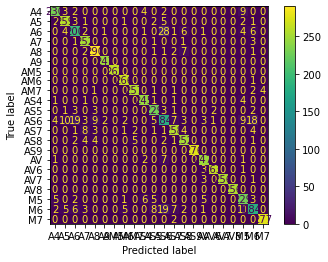

<Figure size 2880x2880 with 0 Axes>

In [69]:
X = fuel_data_df.drop(['Transmission','Make','Model'], axis =1) #This is no neighbor to work with so we drop MAKE AND MODEL
y = fuel_data_df['Transmission']
train_and_evaluate_ds(X, y)

                          precision    recall  f1-score   support

                 COMPACT       0.56      0.47      0.51       191
               FULL-SIZE       0.78      0.84      0.81       182
                MID-SIZE       0.60      0.61      0.61       179
             MINICOMPACT       0.88      0.92      0.90       213
                 MINIVAN       0.95      0.96      0.96       184
    PICKUP TRUCK - SMALL       0.93      0.99      0.96       167
 PICKUP TRUCK - STANDARD       0.90      0.90      0.90       198
 SPECIAL PURPOSE VEHICLE       1.00      0.99      0.99       184
STATION WAGON - MID-SIZE       0.96      0.98      0.97       205
   STATION WAGON - SMALL       0.80      0.82      0.81       194
              SUBCOMPACT       0.70      0.62      0.66       200
                     SUV       0.84      0.69      0.76       194
             SUV - SMALL       0.84      0.86      0.85       193
          SUV - STANDARD       0.92      0.94      0.93       188
         

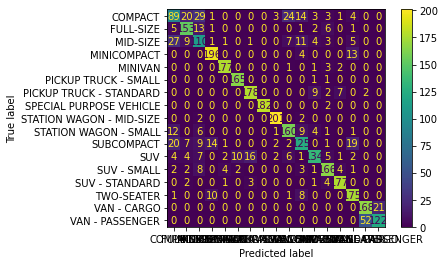

<Figure size 2880x2880 with 0 Axes>

In [70]:
X = fuel_data_df.drop(['Vehicle_Class','Make','Model'], axis =1) #This is no neighbor to work with so we drop MAKE AND MODEL
y = fuel_data_df['Vehicle_Class']
train_and_evaluate_ds(X, y)


Fuel Consumption seem to have the best performance using RandomForestClassifier as shown above.

### Task 8
### Clustering evaluation


In [71]:
# from sklearn.metrics import davies_bouldin_score, silhouette_score

In [72]:
from sklearn.cluster import KMeans

In [73]:
numeric_df['Model_Year'] = numeric_df['Model_Year'].apply(str)

numeric_df

<ipython-input-73-e0ece3f7b707>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  numeric_df['Model_Year'] = numeric_df['Model_Year'].apply(str)


,Model_Year,Engine_Size,Cylinders,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions
1,2010,2.0,4.0,10.9,7.8,9.5,30.0,219.0
2,2010,2.0,4.0,10.0,7.6,8.9,32.0,205.0
3,2010,2.0,4.0,11.6,8.1,10.0,28.0,230.0
4,2010,3.7,6.0,14.8,11.3,13.2,21.0,304.0
5,2010,2.3,4.0,13.2,10.3,11.9,24.0,274.0
...,...,...,...,...,...,...,...,...
5355,2014,3.0,6.0,13.4,9.8,11.8,24.0,271.0
5356,2014,3.2,6.0,13.2,9.5,11.5,25.0,264.0
5357,2014,3.0,6.0,13.4,9.8,11.8,24.0,271.0
5358,2014,3.2,6.0,12.9,9.3,11.3,25.0,260.0


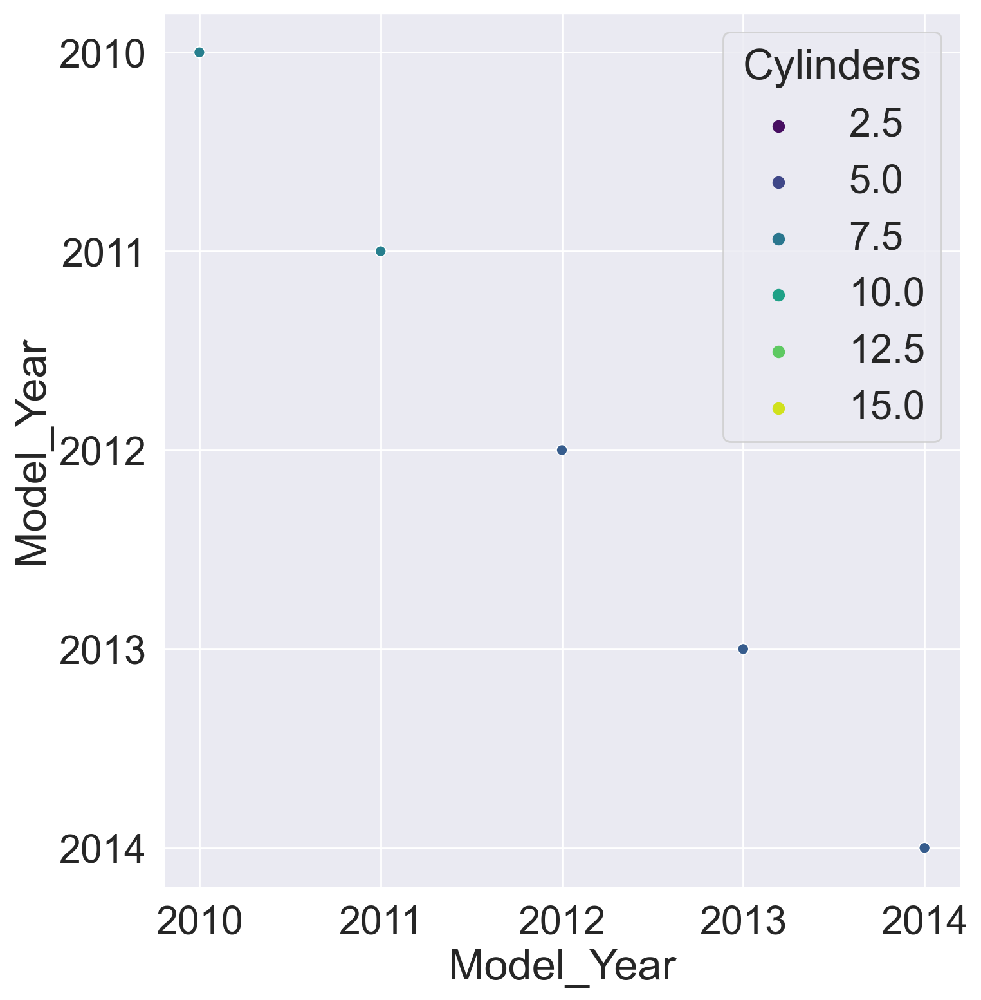

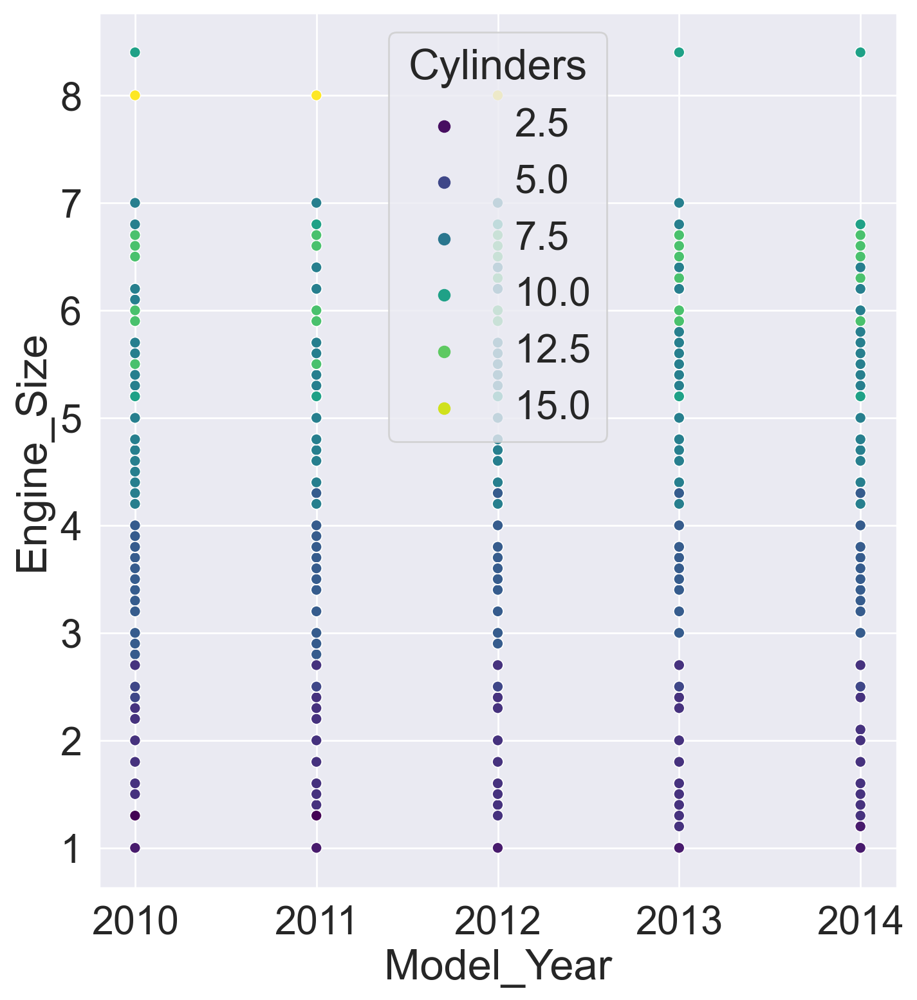

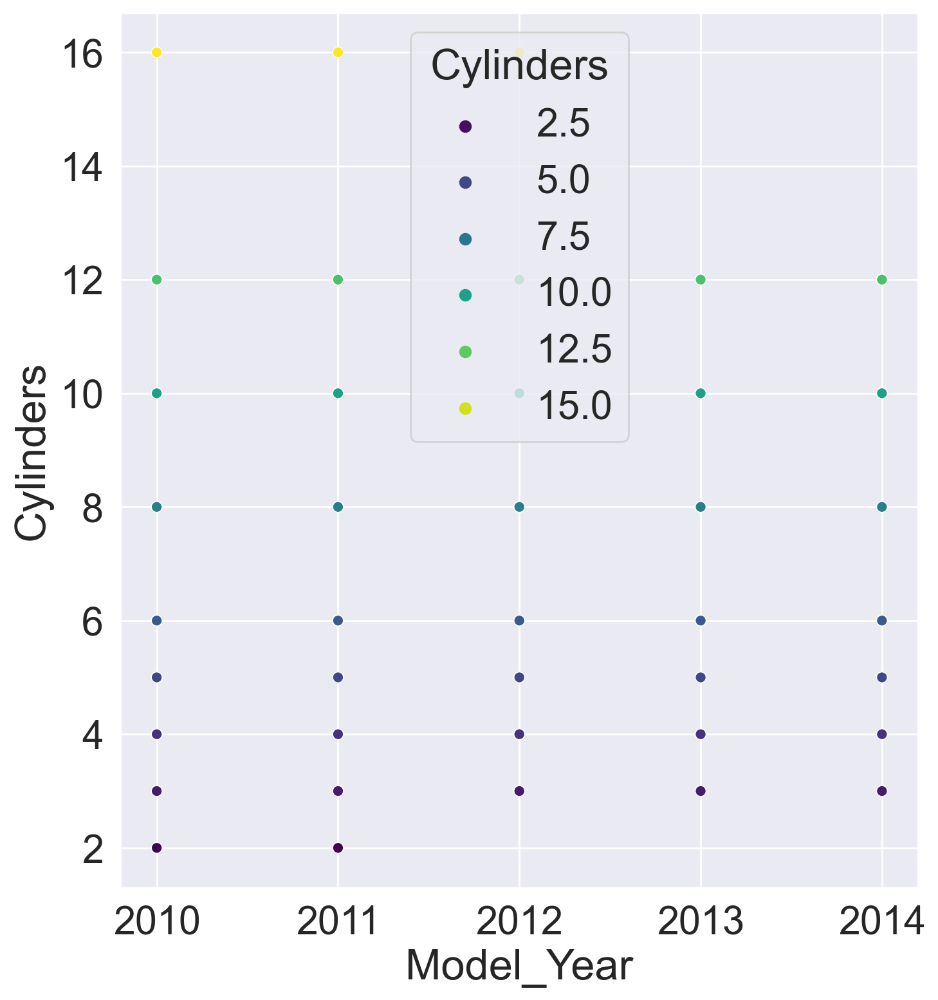

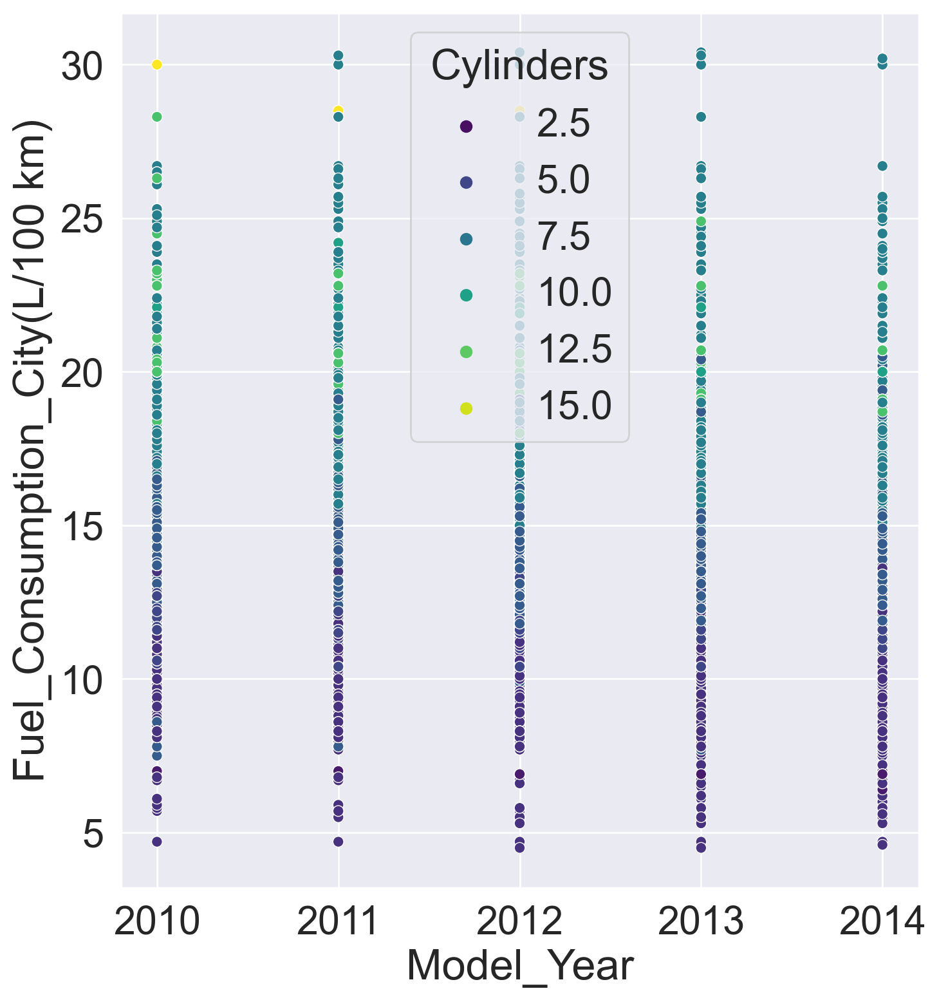

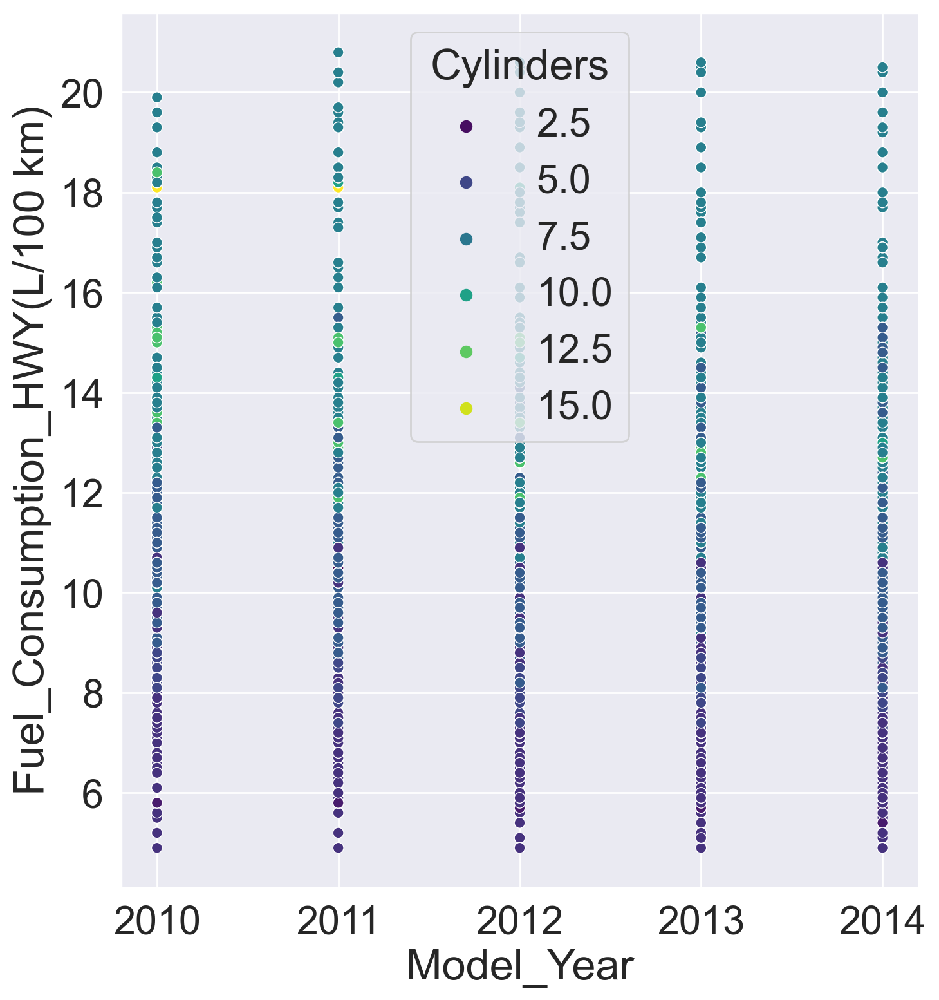

...

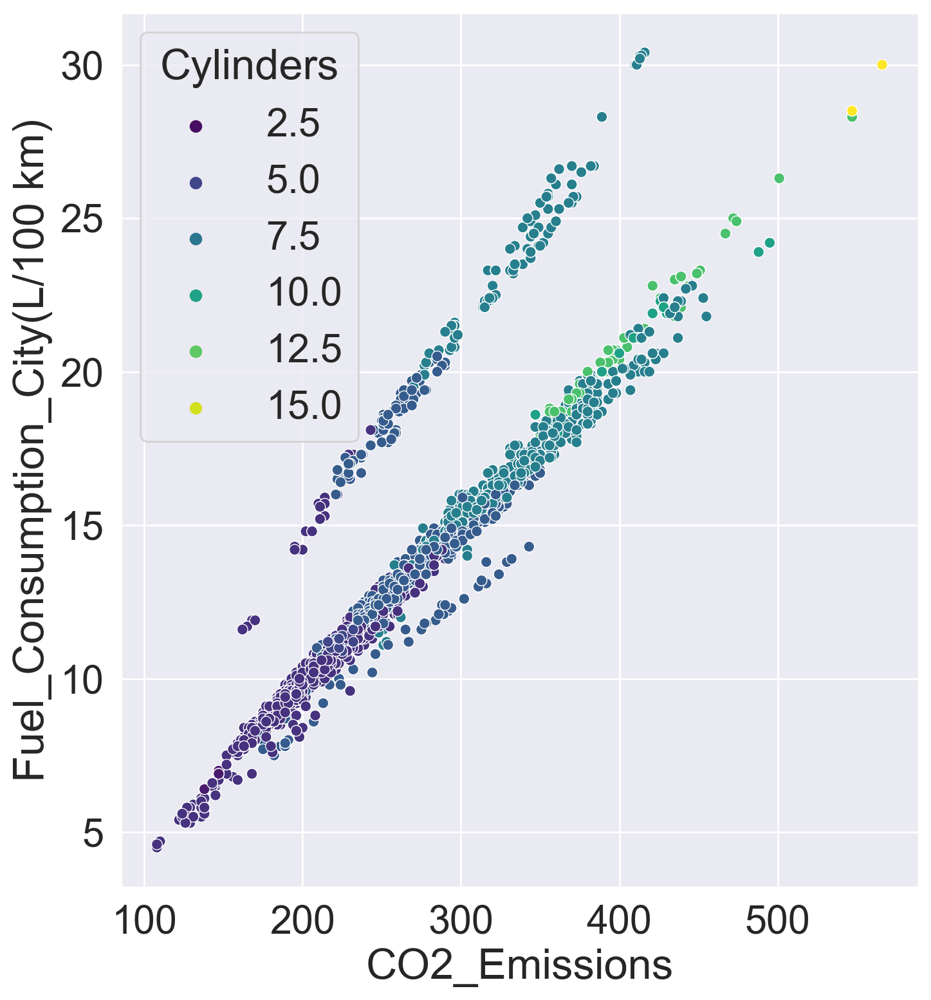

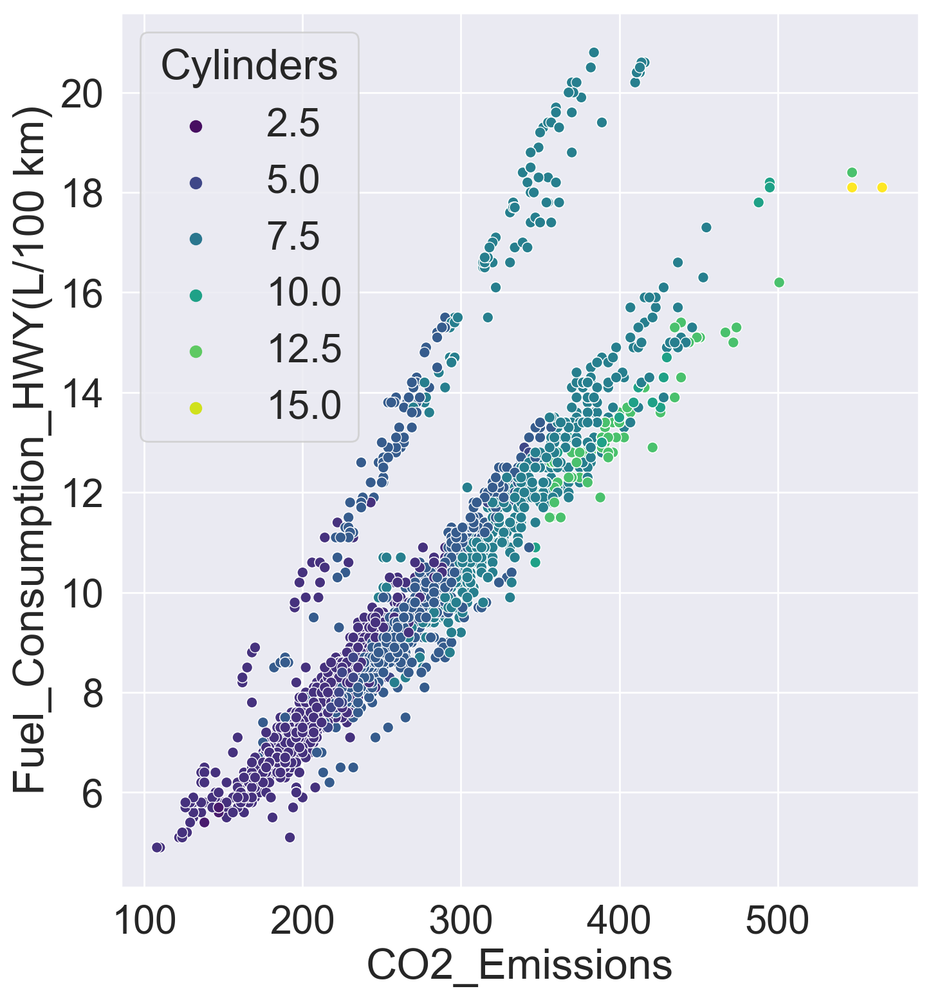

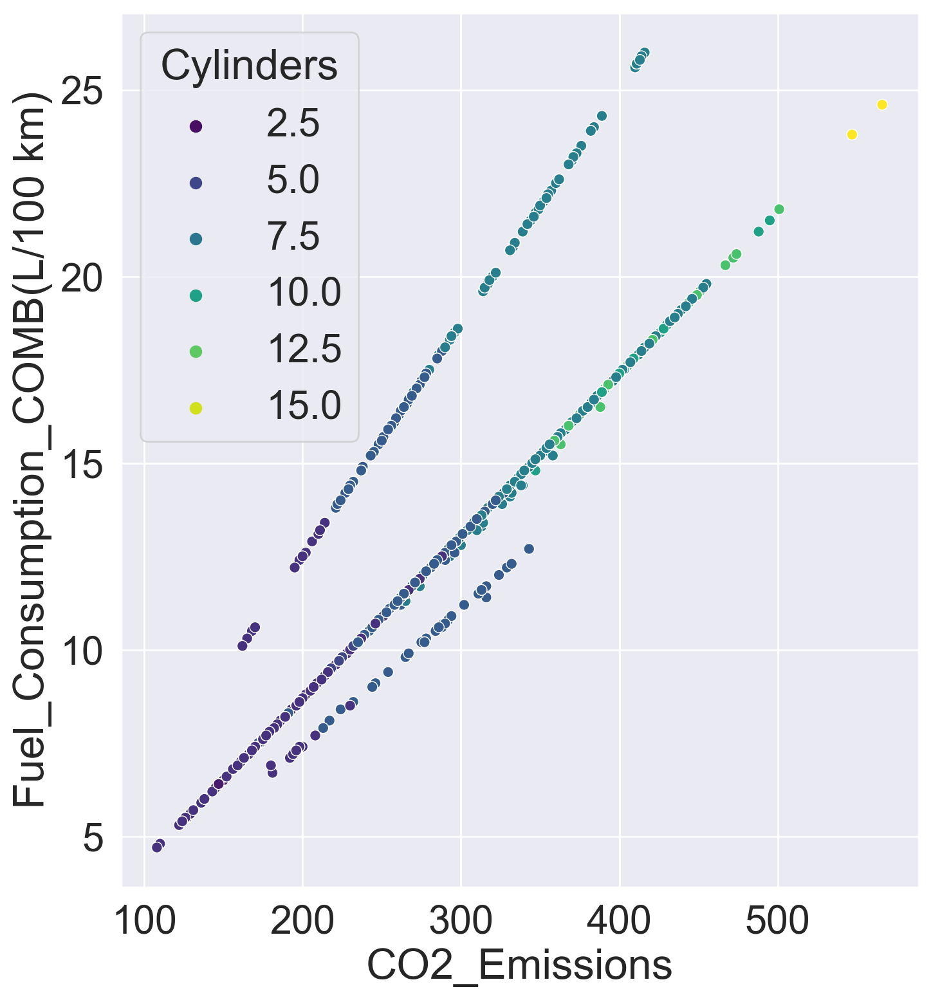

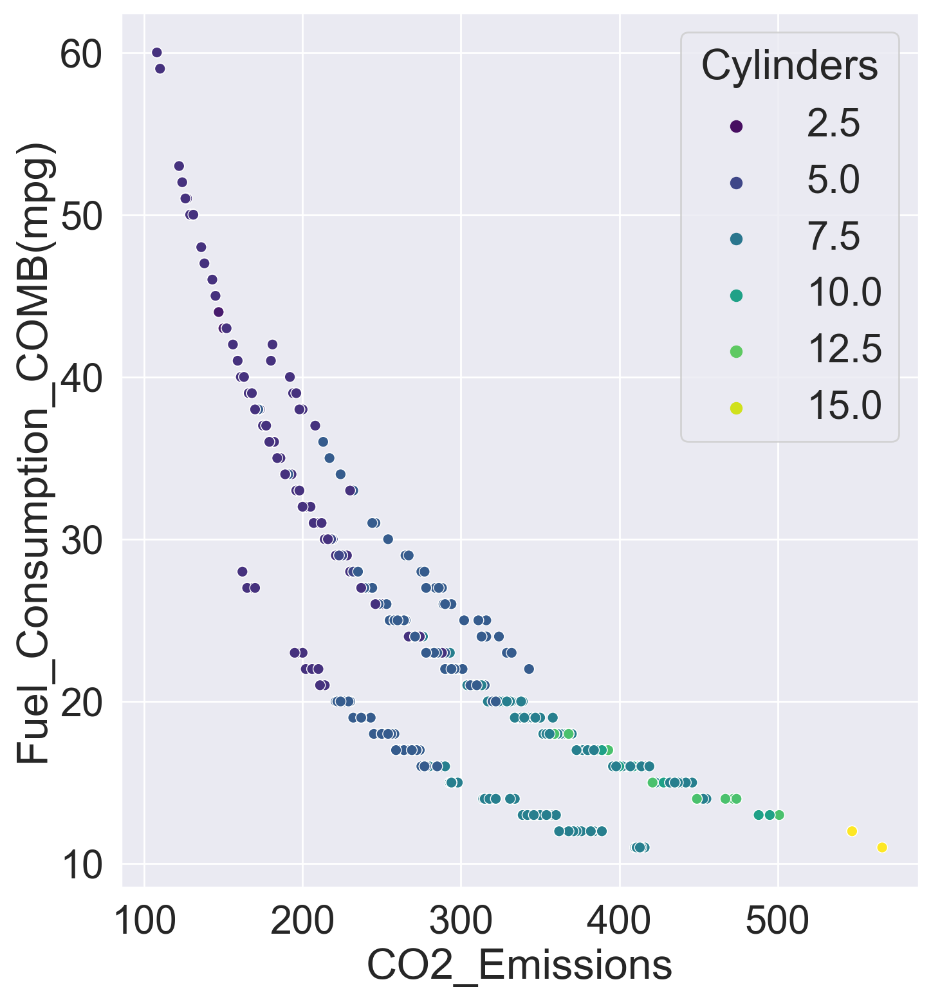

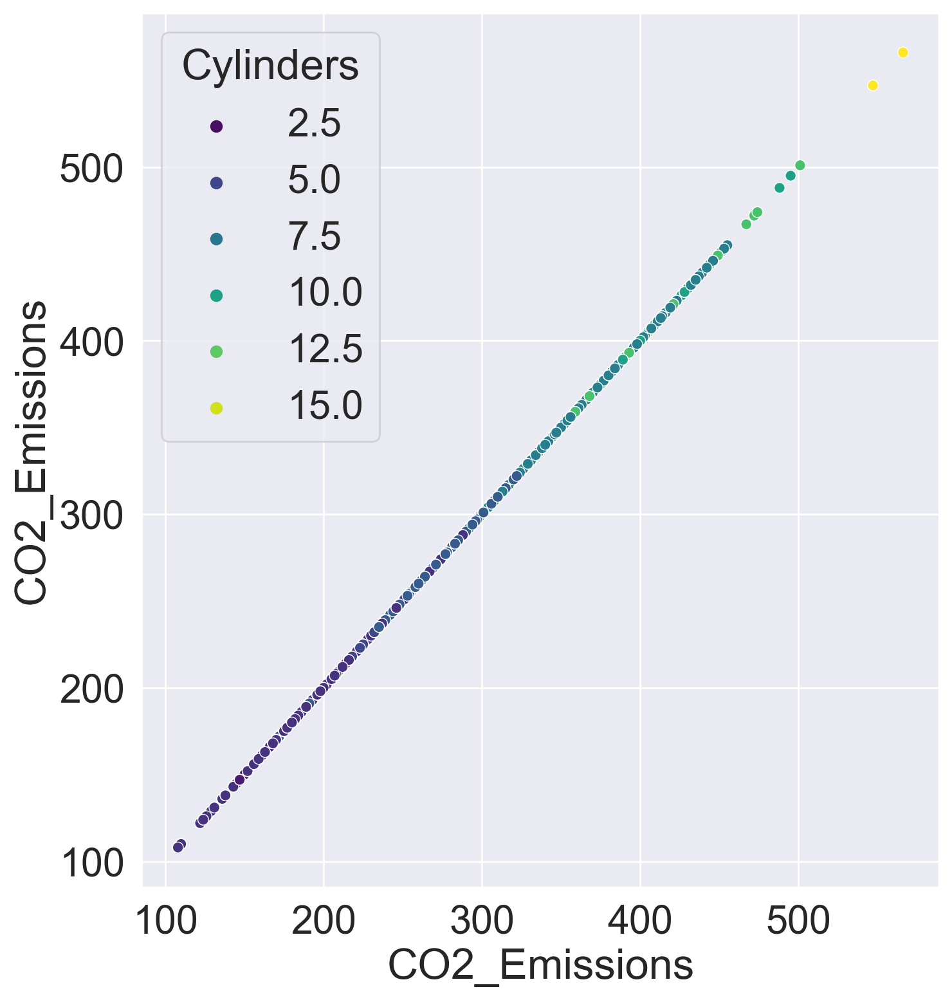

In [74]:
for col1 in numeric_df.columns:
    
     for col2 in numeric_df.columns:
            
         plt.figure(figsize = (8,9),dpi = 200)
         sns.set(font_scale=2)
         sns.scatterplot(data = numeric_df, x = numeric_df[col1],y = numeric_df[col2],
         hue='Cylinders', palette = 'viridis')
         plt.show()


In [75]:
numeric_df.drop('Model_Year', axis = 1, inplace = True) 

C:\Program Files\ArcGIS\Pro\bin\Python\envs\arcgispro-py3\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [76]:
from sklearn.preprocessing import StandardScaler

In [77]:
scaler = StandardScaler()

In [78]:
scaled_numeric_df = scaler.fit_transform(numeric_df)
scaled_numeric_df

array([[-1.0726722 , -1.04776951, -0.72135632, ..., -0.74247367,
         0.69455053, -0.75663834],
       [-1.0726722 , -1.04776951, -0.93757224, ..., -0.91274447,
         0.98208211, -0.97433036],
       [-1.0726722 , -1.04776951, -0.55318838, ..., -0.60058134,
         0.40701895, -0.58559461],
       ...,
       [-0.35367552,  0.02022798, -0.12075653, ..., -0.08976894,
        -0.16804421,  0.05193202],
       [-0.20987619,  0.02022798, -0.24087649, ..., -0.23166128,
        -0.02427842, -0.11911171],
       [-0.20987619,  0.02022798,  0.23960334, ...,  0.19401572,
        -0.45557579,  0.40956891]])

### Internal evaluation metrics

C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warni

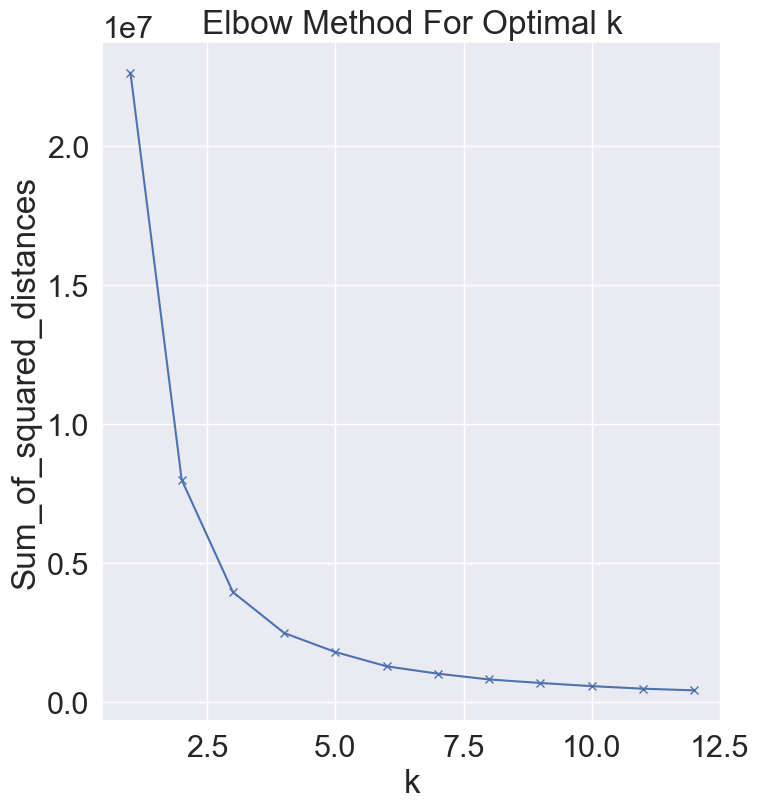

In [79]:
# Internal evaluation metrics using elbow methods.

Sum_of_squared_distances = []

K = range(1,13)
for i in K:
    km = KMeans(n_clusters=i)
    km = km.fit(numeric_df)
    Sum_of_squared_distances.append(km.inertia_)

plt.figure(figsize = (8,9),dpi = 100)
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [109]:
# Internal evaluation metrics using silhouette_score and davies_bouldin_score.

from sklearn.metrics import silhouette_score, davies_bouldin_score, v_measure_score,rand_score

k_list = []
k = range(2,8)
for i in k:
    km = KMeans (n_clusters = i)
    cluster_labels = km.fit_predict(numeric_df)
    centers = km.cluster_centers_
    silh_value = silhouette_score(numeric_df, cluster_labels)
    db_index = davies_bouldin_score(numeric_df, cluster_labels)
    k_list.append((i, silh_value, db_index,((1-db_index)*silh_value)))



k_list_df = pd.DataFrame(k_list, columns = ['K', 'silhouette_score', 'davies_bouldin_score','avg_score'])
# k_list_df.(index=0, inplace=True) 
k_list_df

C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warni

,K,silhouette_score,davies_bouldin_score,avg_score
0,2,0.567671,0.607967,0.222546
1,3,0.542456,0.559644,0.238874
2,4,0.527222,0.545839,0.239444
3,5,0.504873,0.581817,0.211129
4,6,0.517865,0.568882,0.223261
5,7,0.507631,0.561408,0.222643


In [81]:
model = KMeans(n_clusters=3)

In [82]:
cluster_labels = model.fit_predict(scaled_numeric_df) # fiting and predicting the clusters
cluster_labels

C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([1, 1, 1, ..., 0, 0, 0])

In [93]:
numeric_df['Cluster'] = cluster_labels

<ipython-input-93-45fac23eb322>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  numeric_df['Cluster'] = cluster_labels


In [94]:
numeric_df

,Engine_Size,Cylinders,Fuel_Consumption_City(L/100 km),Fuel_Consumption_HWY(L/100 km),Fuel_Consumption_COMB(L/100 km),Fuel_Consumption_COMB(mpg),CO2_Emissions,Cluster
1,2.0,4.0,10.9,7.8,9.5,30.0,219.0,1
2,2.0,4.0,10.0,7.6,8.9,32.0,205.0,1
3,2.0,4.0,11.6,8.1,10.0,28.0,230.0,1
4,3.7,6.0,14.8,11.3,13.2,21.0,304.0,0
5,2.3,4.0,13.2,10.3,11.9,24.0,274.0,0
...,...,...,...,...,...,...,...,...
5355,3.0,6.0,13.4,9.8,11.8,24.0,271.0,0
5356,3.2,6.0,13.2,9.5,11.5,25.0,264.0,0
5357,3.0,6.0,13.4,9.8,11.8,24.0,271.0,0
5358,3.2,6.0,12.9,9.3,11.3,25.0,260.0,0


In [95]:
cluster_labels

array([1, 1, 1, ..., 0, 0, 0])

In [ ]:
numeric_df.drop('Cluster', axis = 1, inplace = True)
for col1 in numeric_df.columns:
     for col2 in numeric_df.columns:
         plt.figure(figsize = (8,9),dpi = 200)
         sns.set(font_scale=2)
         sns.scatterplot(data = numeric_df, x = numeric_df[col1],y = numeric_df[col2],
         hue=cluster_labels, palette = 'viridis')
         plt.show()

### External evaluation metrics

In [111]:
# External evaluation metrics using rand_score

km = KMeans(n_clusters= 30)
labels = km.fit_predict(scaled_numeric_df)
object_df.apply(lambda x: rand_score(x,labels))

C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Model_Year       0.768387
Make             0.912525
Model            0.945891
Vehicle_Class    0.872974
Transmission     0.848060
Fuel             0.594292
dtype: float64

In [112]:
# External evaluation metrics using v_measure_score

km = KMeans(n_clusters= 30)
labels = km.fit_predict(scaled_numeric_df)
object_df.apply(lambda x: v_measure_score(x,labels))

C:\Users\701316\AppData\Roaming\Python\Python39\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Model_Year       0.013544
Make             0.276378
Model            0.512122
Vehicle_Class    0.231854
Transmission     0.176471
Fuel             0.200315
dtype: float64

Model has the best evaluation metrics score